In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
import seaborn as sns

# Loading

In [23]:
data_emotion = pd.read_csv('/workspaces/wiggle-face/src/loading_and_feature_extraction/Data_initial_features_labeled_2.csv')

In [24]:
data_emotion['emotion'] = data_emotion['emotion'].replace('aversion', 'sleepy')

In [25]:
def categorize_emotion(emotion):
    if emotion in ['interest', 'surprise', 'playful']:
        return 'positive'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['sadness', 'anger']:
        return 'negative'

def categorize_emotion_2(emotion):
    if emotion in ['anger', 'playful']:
        return 'intense'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['interest', 'surprise', 'sadness']:
        return 'mild'
    
# Apply the categorization function to create 'emotion_category'
data_emotion['emotion_category'] = data_emotion['emotion'].apply(categorize_emotion)
data_emotion['emotion_category_2'] = data_emotion['emotion'].apply(categorize_emotion_2)

In [26]:
data_filtered = data_emotion[data_emotion['age'].isnull()]
data_emotion_panda_1_panda_3 = data_filtered.drop(columns=['age'])
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3[['infant_id','date', 'cam', 'frame_id','emotion', 'emotion_category', 'emotion_category_2']]
data_emotion_panda_1_panda_3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 448436 entries, 0 to 1285000
Data columns (total 7 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   infant_id           448436 non-null  int64  
 1   date                448436 non-null  float64
 2   cam                 448436 non-null  float64
 3   frame_id            448436 non-null  int64  
 4   emotion             448436 non-null  object 
 5   emotion_category    448436 non-null  object 
 6   emotion_category_2  448436 non-null  object 
dtypes: float64(2), int64(2), object(3)
memory usage: 27.4+ MB


In [27]:
file_path = '/workspaces/wiggle-face/data-ioana/CLIN/clin_data_113_infants.csv'
df_clin = pd.read_csv(file_path)

# Ensure 'infant_id' is formatted to three digits
df_clin['infant_id'] = df_clin['infant_id'].apply(lambda x: f"{int(x):03d}")
df_clin['infant_id'] = df_clin['infant_id'].apply(lambda x: int(x))
df_clin.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113 entries, 0 to 112
Data columns (total 2 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   infant_id     113 non-null    int64
 1   brain_injury  113 non-null    int64
dtypes: int64(2)
memory usage: 1.9 KB


In [28]:
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.merge(df_clin[['infant_id', 'brain_injury']], on='infant_id', how='inner')

In [29]:
data_emotion_panda_1_panda_3

,infant_id,date,cam,frame_id,emotion,emotion_category,emotion_category_2,brain_injury
0,28,19233.0,3.0,1,neutral,neutral,neutral,0
1,28,19233.0,3.0,2,neutral,neutral,neutral,0
2,28,19233.0,3.0,3,neutral,neutral,neutral,0
3,28,19233.0,3.0,4,neutral,neutral,neutral,0
4,28,19233.0,3.0,5,neutral,neutral,neutral,0
...,...,...,...,...,...,...,...,...
444356,243,19844.0,3.0,7393,neutral,neutral,neutral,1
444357,243,19844.0,3.0,7394,neutral,neutral,neutral,1
444358,243,19844.0,3.0,7395,neutral,neutral,neutral,1
444359,243,19844.0,3.0,7396,neutral,neutral,neutral,1


In [30]:
data_emotion_panda_1_panda_3['date'] = pd.to_datetime(data_emotion_panda_1_panda_3['date'], origin='1970-01-01', unit='D')
data_emotion_panda_1_panda_3['date'] = data_emotion_panda_1_panda_3['date'].dt.strftime('%Y_%m_%d')
data_emotion_panda_1_panda_3['cam'] = data_emotion_panda_1_panda_3['cam'].astype(int)
data_emotion_panda_1_panda_3['infant_id'] = data_emotion_panda_1_panda_3['infant_id'].apply(lambda x: f"{int(x):03}")

In [31]:
data_emotion_panda_1_panda_3['video'] = data_emotion_panda_1_panda_3.apply(
    lambda row: f"r_{row['date']}_833180_{row['infant_id']}_cam{row['cam']}_vid4", axis=1
)
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.drop(columns = ['date', 'cam','infant_id'])
data_emotion_panda_1_panda_3 = data_emotion_panda_1_panda_3.reset_index(drop=True)
data_emotion_panda_1_panda_3.head(90900)

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video
0,1,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
1,2,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
2,3,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
3,4,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
4,5,neutral,neutral,neutral,0,r_2022_08_29_833180_028_cam3_vid4
...,...,...,...,...,...,...
90895,6782,sleepy,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90896,6783,sleepy,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90897,6784,sleepy,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4
90898,6785,neutral,neutral,neutral,0,r_2022_08_23_833180_026_cam3_vid4


# Selecting Videos

video ids: 
211 (BI norm): 'r_2022_07_28_833180_211_cam3_vid4','r_2022_09_08_833180_211_cam3_vid4','r_2022_10_05_833180_211_cam3_vid4','r_2022_07_01_833180_211_cam3_vid4',
222 (norm): 'r_2023_02_20_833180_222_cam3_vid4','r_2022_10_20_833180_222_cam3_vid4', 'r_2022_11_22_833180_222_cam3_vid4',
'r_2022_12_20_833180_222_cam3_vid4'
227 (norm): 'r_2023_05_03_833180_227_cam3_vid4','r_2023_06_22_833180_227_cam3_vid4','r_2023_02_24_833180_227_cam3_vid4', 'r_2023_03_17_833180_227_cam3_vid4', 
229 (BI norm): 'r_2023_06_21_833180_229_cam3_vid4','r_2023_07_19_833180_229_cam3_vid4','r_2023_09_27_833180_229_cam3_vid4'
238 (BI): 'r_2024_03_08_833180_238_cam3_vid4','r_2024_04_05_833180_238_cam3_vid4','r_2024_02_07_833180_238_cam3_vid4','r_2024_05_08_833180_238_cam3_vid4',
242 (BI): 'r_2024_02_23_833180_242_cam3_vid4','r_2024_03_08_833180_242_cam3_vid4','r_2024_04_05_833180_242_cam3_vid4','r_2024_05_10_833180_242_cam3_vid4'

In [32]:
video_id_list = ['r_2024_02_23_833180_242_cam3_vid4','r_2024_03_08_833180_242_cam3_vid4','r_2024_04_05_833180_242_cam3_vid4','r_2024_05_10_833180_242_cam3_vid4',
                 'r_2024_03_08_833180_238_cam3_vid4','r_2024_04_05_833180_238_cam3_vid4','r_2024_02_07_833180_238_cam3_vid4','r_2024_05_08_833180_238_cam3_vid4',
                   'r_2023_06_21_833180_229_cam3_vid4','r_2023_07_19_833180_229_cam3_vid4','r_2023_09_27_833180_229_cam3_vid4','r_2023_05_03_833180_227_cam3_vid4',
                   'r_2023_06_22_833180_227_cam3_vid4','r_2023_02_24_833180_227_cam3_vid4', 'r_2023_03_17_833180_227_cam3_vid4', 'r_2023_02_20_833180_222_cam3_vid4',
                   'r_2022_10_20_833180_222_cam3_vid4', 'r_2022_11_22_833180_222_cam3_vid4','r_2022_12_20_833180_222_cam3_vid4','r_2022_07_28_833180_211_cam3_vid4',
                   'r_2022_09_08_833180_211_cam3_vid4','r_2022_10_05_833180_211_cam3_vid4','r_2022_07_01_833180_211_cam3_vid4']

filtered_data = data_emotion_panda_1_panda_3[data_emotion_panda_1_panda_3['video'].isin(video_id_list)]

In [33]:
filtered_data = filtered_data.reset_index(drop=True)
filtered_data

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video
0,638,neutral,neutral,neutral,1,r_2024_02_07_833180_238_cam3_vid4
1,639,neutral,neutral,neutral,1,r_2024_02_07_833180_238_cam3_vid4
2,640,neutral,neutral,neutral,1,r_2024_02_07_833180_238_cam3_vid4
3,641,neutral,neutral,neutral,1,r_2024_02_07_833180_238_cam3_vid4
4,642,neutral,neutral,neutral,1,r_2024_02_07_833180_238_cam3_vid4
...,...,...,...,...,...,...
30793,3847,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
30794,3848,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
30795,3849,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
30796,3850,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4


In [34]:
filtered_data_2 = filtered_data[filtered_data['video'].isin(['r_2023_02_24_833180_227_cam3_vid4'])].reset_index(drop=True)
filtered_data_2

,frame_id,emotion,emotion_category,emotion_category_2,brain_injury,video
0,39,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
1,40,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
2,41,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
3,42,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
4,43,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
...,...,...,...,...,...,...
965,3847,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
966,3848,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
967,3849,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4
968,3850,neutral,neutral,neutral,0,r_2023_02_24_833180_227_cam3_vid4


In [35]:
unique_videos = np.array(video_id_list)
unique_videos

array(['r_2024_02_23_833180_242_cam3_vid4',
       'r_2024_03_08_833180_242_cam3_vid4',
       'r_2024_04_05_833180_242_cam3_vid4',
       'r_2024_05_10_833180_242_cam3_vid4',
       'r_2024_03_08_833180_238_cam3_vid4',
       'r_2024_04_05_833180_238_cam3_vid4',
       'r_2024_02_07_833180_238_cam3_vid4',
       'r_2024_05_08_833180_238_cam3_vid4',
       'r_2023_06_21_833180_229_cam3_vid4',
       'r_2023_07_19_833180_229_cam3_vid4',
       'r_2023_09_27_833180_229_cam3_vid4',
       'r_2023_05_03_833180_227_cam3_vid4',
       'r_2023_06_22_833180_227_cam3_vid4',
       'r_2023_02_24_833180_227_cam3_vid4',
       'r_2023_03_17_833180_227_cam3_vid4',
       'r_2023_02_20_833180_222_cam3_vid4',
       'r_2022_10_20_833180_222_cam3_vid4',
       'r_2022_11_22_833180_222_cam3_vid4',
       'r_2022_12_20_833180_222_cam3_vid4',
       'r_2022_07_28_833180_211_cam3_vid4',
       'r_2022_09_08_833180_211_cam3_vid4',
       'r_2022_10_05_833180_211_cam3_vid4',
       'r_2022_07_01_833180_211_

In [36]:
unique_videos = np.array(video_id_list)

# Desired frame IDs
desired_frame_ids = range(1, 7201)

# Create a DataFrame with all combinations of video and frame_id
all_combinations = pd.DataFrame([(video, frame_id) for video in unique_videos for frame_id in desired_frame_ids], columns=['video', 'frame_id'])

# Merge the existing data with all_combinations
merged_data = pd.merge(all_combinations, filtered_data, on=['video', 'frame_id'], how='left')

# Fill the brain_injury status for each video
for video in unique_videos:
    if video in filtered_data['video'].values:
        brain_injury_status = filtered_data.loc[filtered_data['video'] == video, 'brain_injury'].iloc[0]
    else:
        brain_injury_status = np.nan  # Or set a default value if preferred
    merged_data.loc[merged_data['video'] == video, 'brain_injury'] = brain_injury_status

In [37]:
merged_data

,video,frame_id,emotion,emotion_category,emotion_category_2,brain_injury
0,r_2024_02_23_833180_242_cam3_vid4,1,NaN,NaN,NaN,NaN
1,r_2024_02_23_833180_242_cam3_vid4,2,NaN,NaN,NaN,NaN
2,r_2024_02_23_833180_242_cam3_vid4,3,NaN,NaN,NaN,NaN
3,r_2024_02_23_833180_242_cam3_vid4,4,NaN,NaN,NaN,NaN
4,r_2024_02_23_833180_242_cam3_vid4,5,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...
165595,r_2022_07_01_833180_211_cam3_vid4,7196,NaN,NaN,NaN,1.0
165596,r_2022_07_01_833180_211_cam3_vid4,7197,NaN,NaN,NaN,1.0
165597,r_2022_07_01_833180_211_cam3_vid4,7198,NaN,NaN,NaN,1.0
165598,r_2022_07_01_833180_211_cam3_vid4,7199,NaN,NaN,NaN,1.0


In [38]:
merged_data.to_csv("Francis_data.csv")

# Visualizer

In [39]:
import cv2

# Function to get the frame from the video
def get_frame(video_path, frame_number):
    cap = cv2.VideoCapture(video_path)
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame_number)
    ret, frame = cap.read()
    cap.release()
    if ret:
        return cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    else:
        print(f"Failed to extract frame {frame_number} from {video_path}")
        return None
    
# function to display a selected row
def display_frame_panda_1_3(frame_id, video_path):

    # get the frame
    frame = get_frame(video_path, frame_id)
        
    if frame is not None:
        plt.figure(figsize=(10, 6))
        plt.imshow(frame)
        plt.axis('off')
        plt.show()
    else:
        print(f"Frame {frame_id} could not be retrieved.")

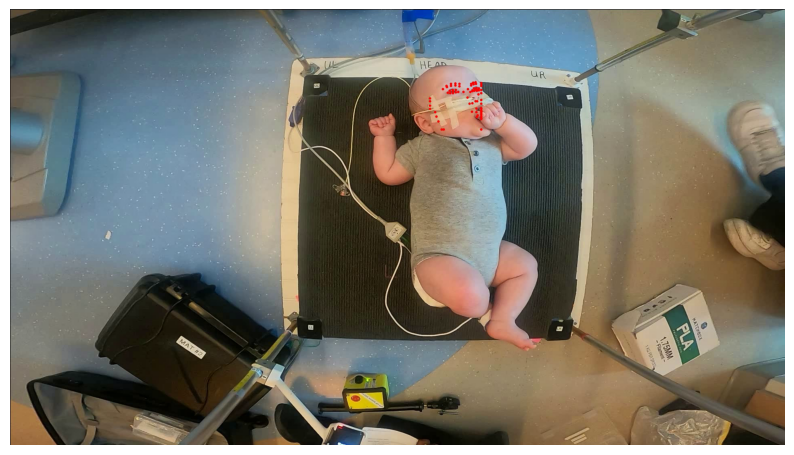

In [40]:
video_path = '/workspaces/wiggle-face/data-ioana/PANDA3/face/vis/r_2024_05_10_833180_242_cam3_vid4.mp4'
display_frame_panda_1_3(3300,video_path)

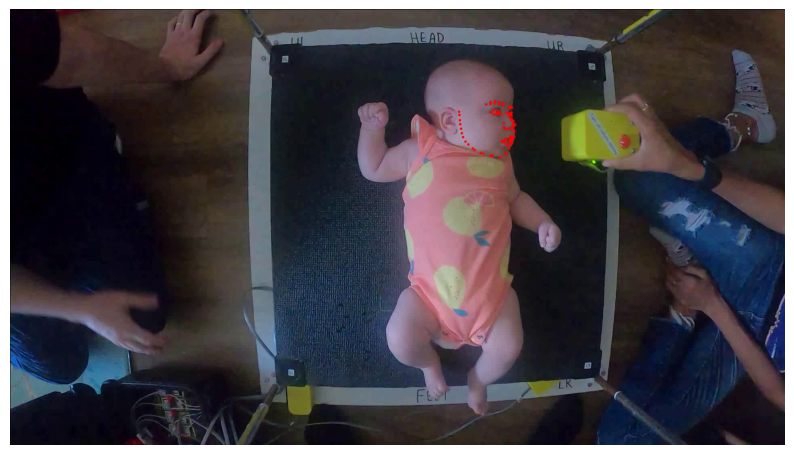

Displayed frame number: 0


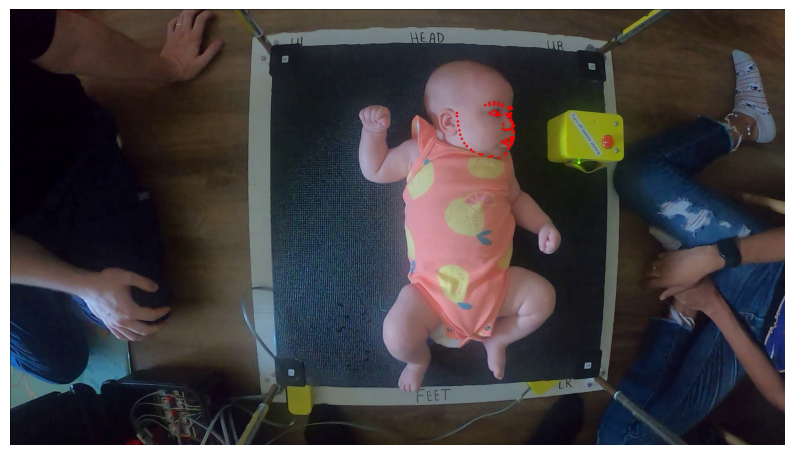

Displayed frame number: 100


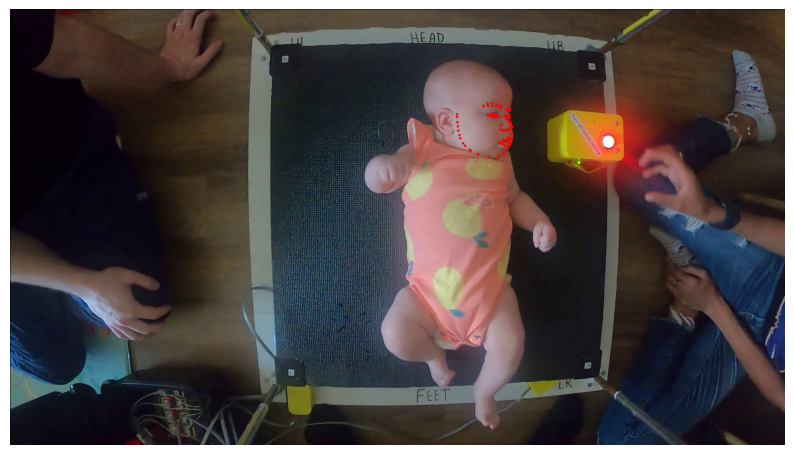

Displayed frame number: 200


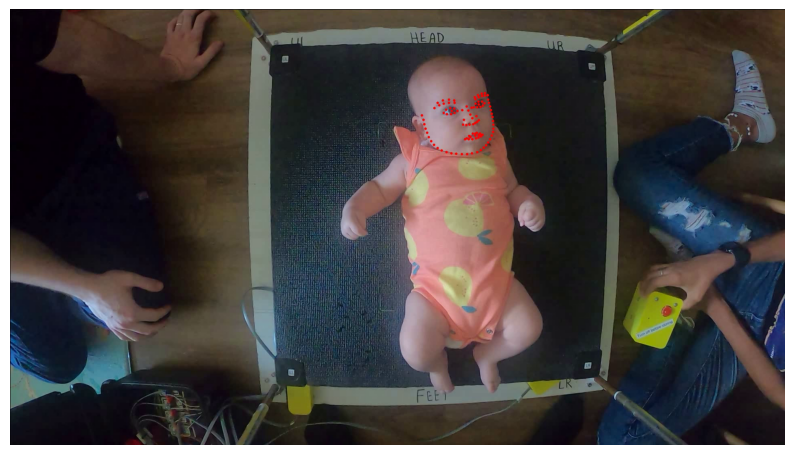

Displayed frame number: 300


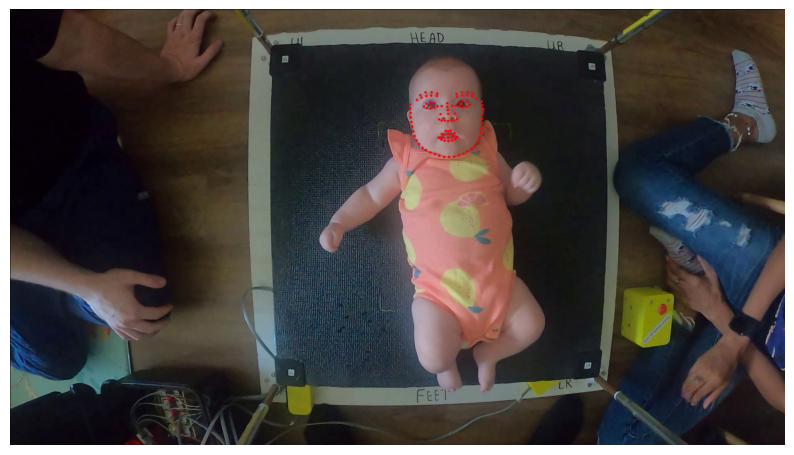

Displayed frame number: 400


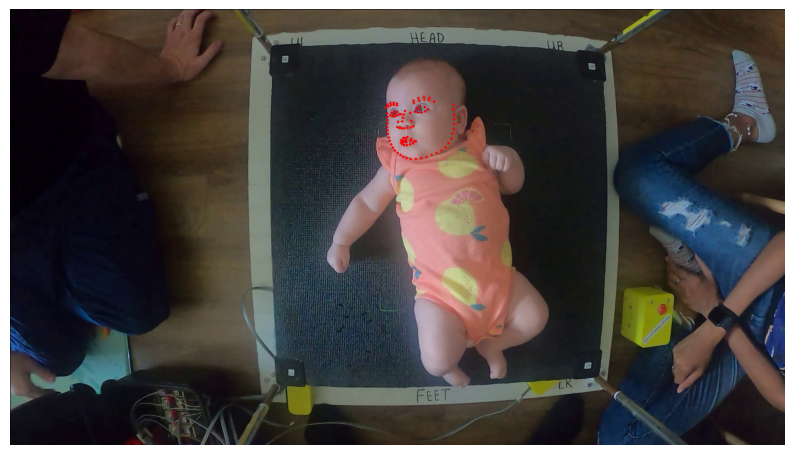

Displayed frame number: 500


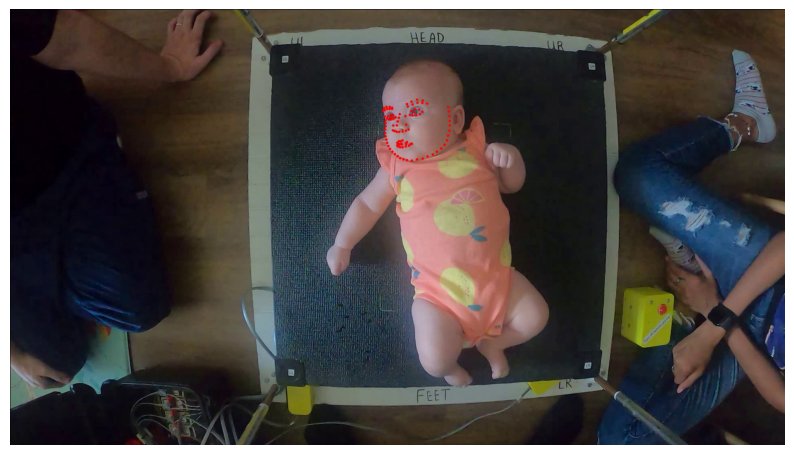

Displayed frame number: 600


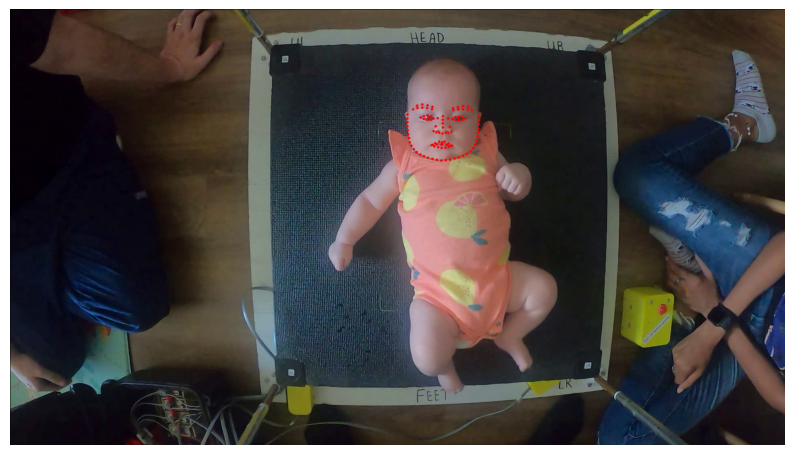

Displayed frame number: 700


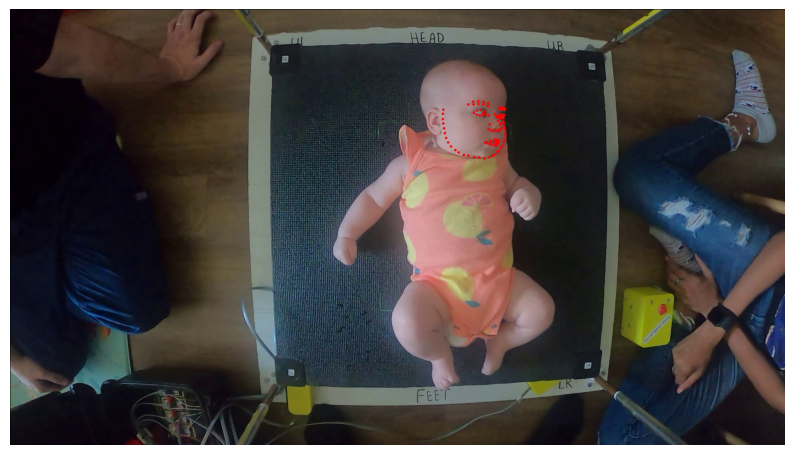

Displayed frame number: 800


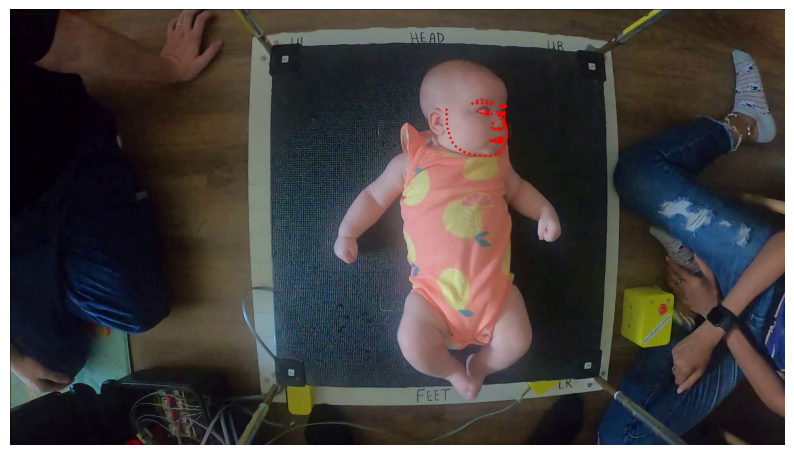

Displayed frame number: 900


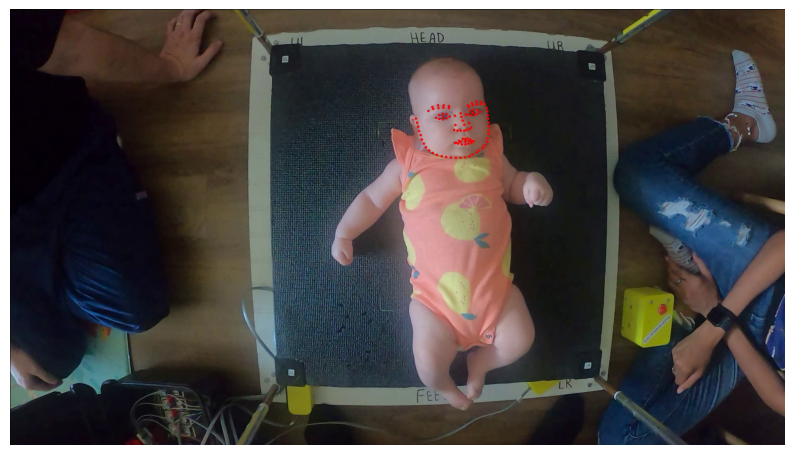

Displayed frame number: 1000


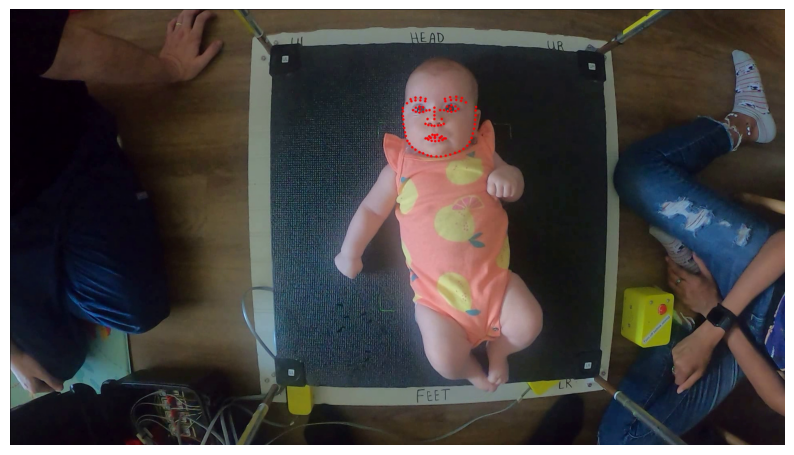

Displayed frame number: 1100


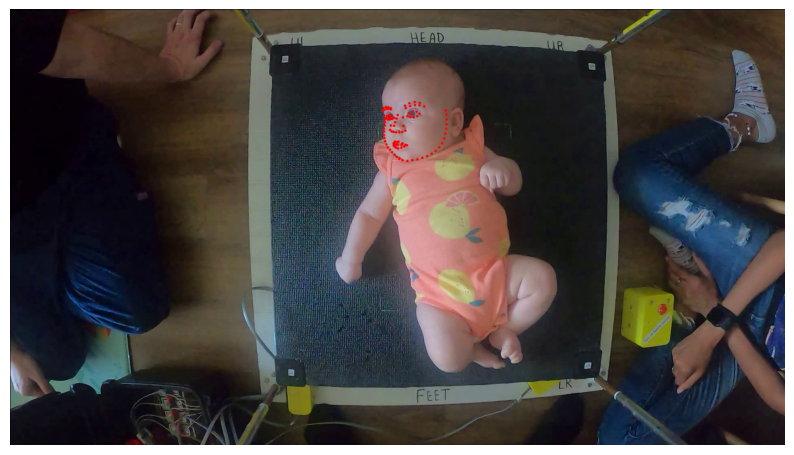

Displayed frame number: 1200


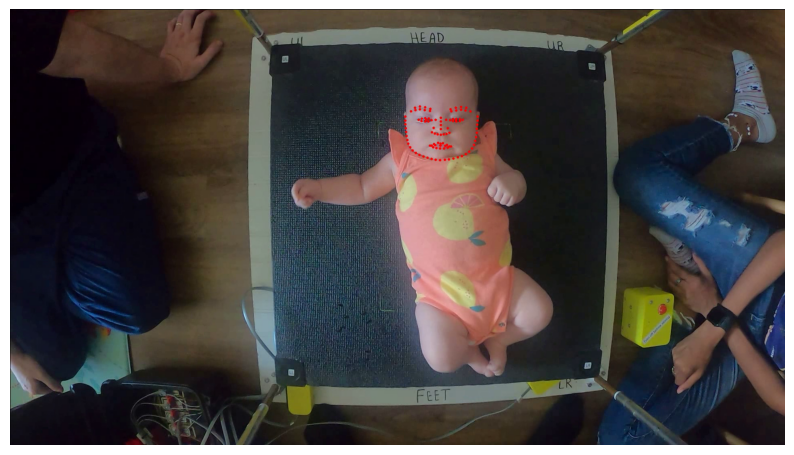

Displayed frame number: 1300


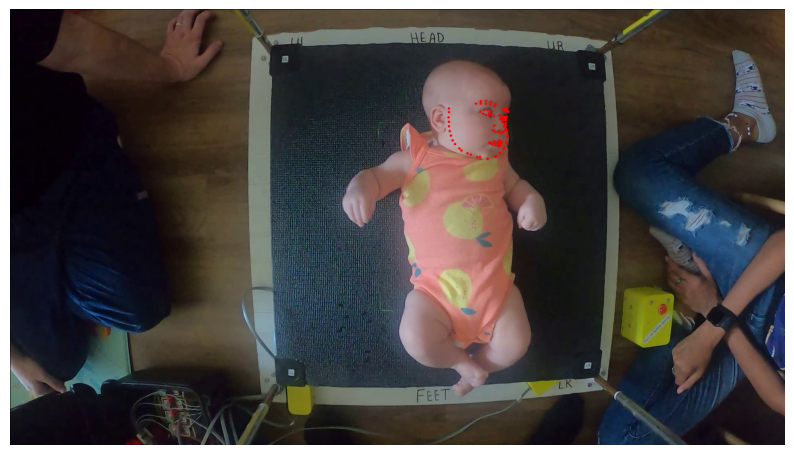

Displayed frame number: 1400


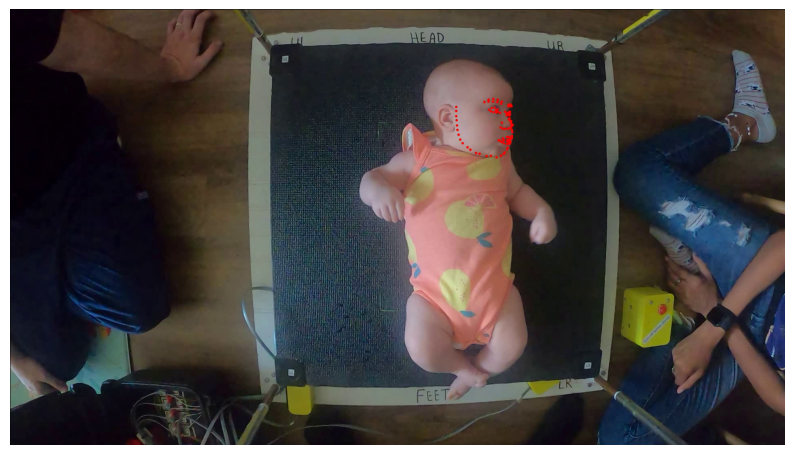

Displayed frame number: 1500


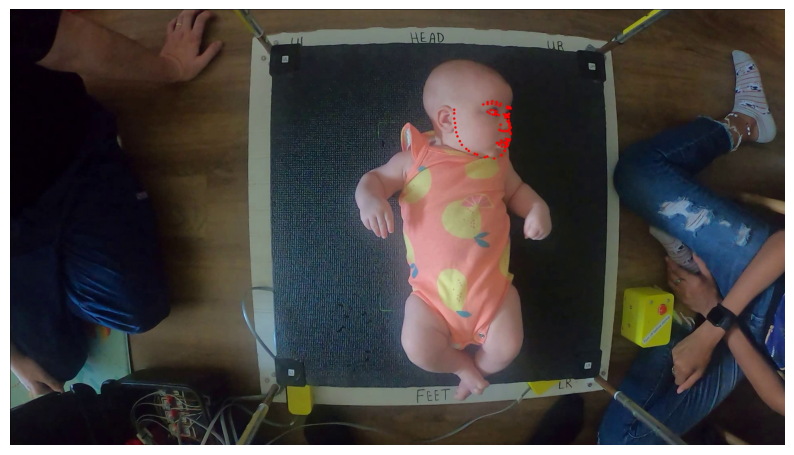

Displayed frame number: 1600


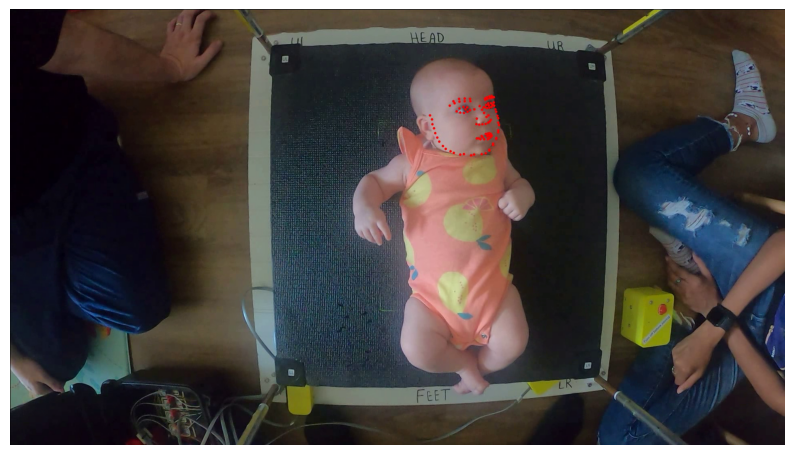

Displayed frame number: 1700


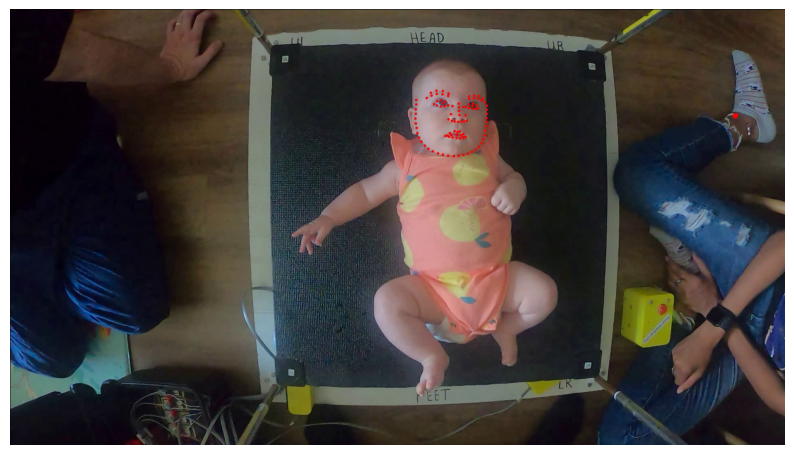

Displayed frame number: 1800


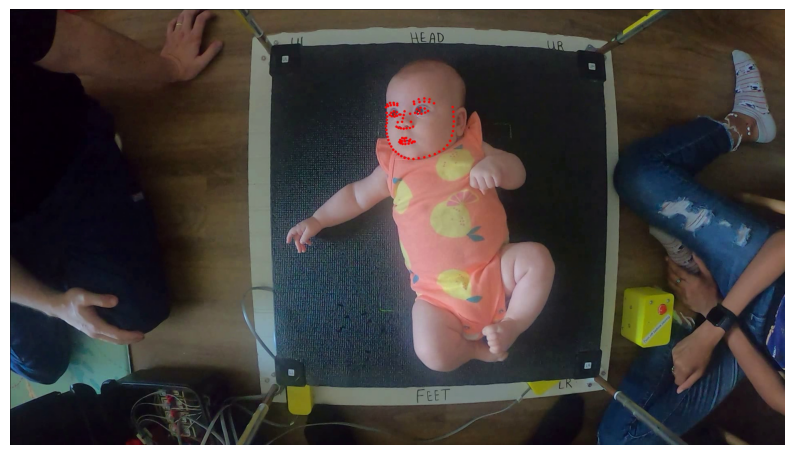

Displayed frame number: 1900


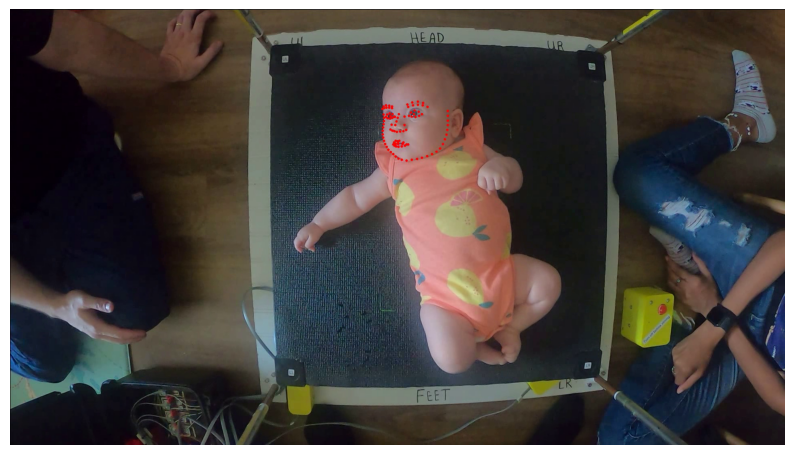

Displayed frame number: 2000


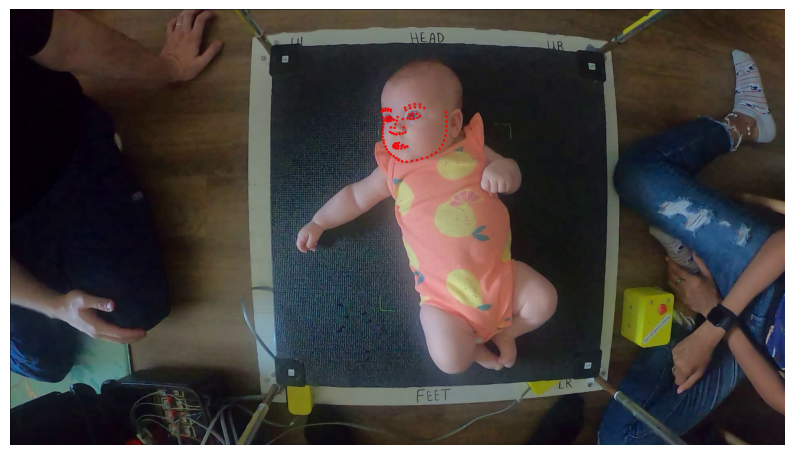

Displayed frame number: 2100


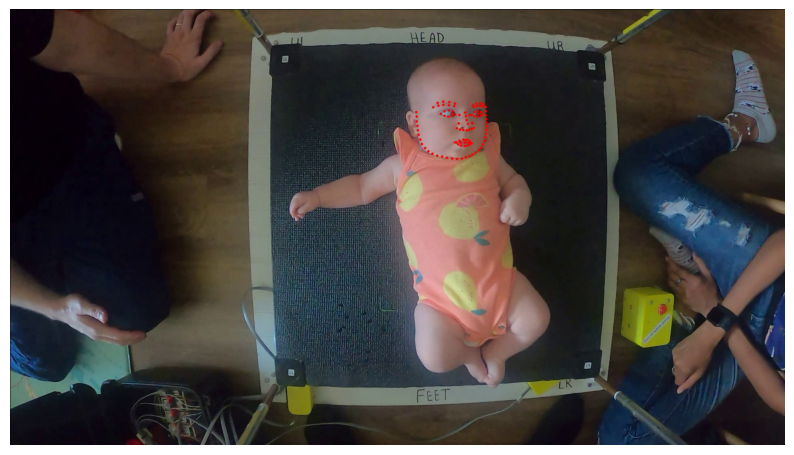

Displayed frame number: 2200


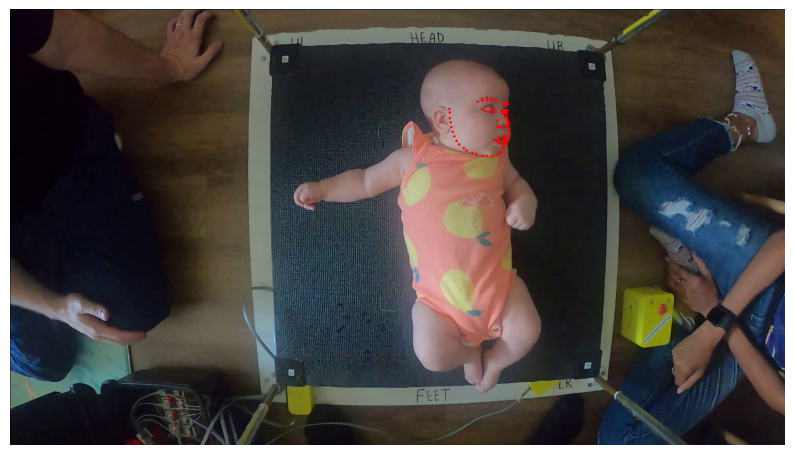

Displayed frame number: 2300


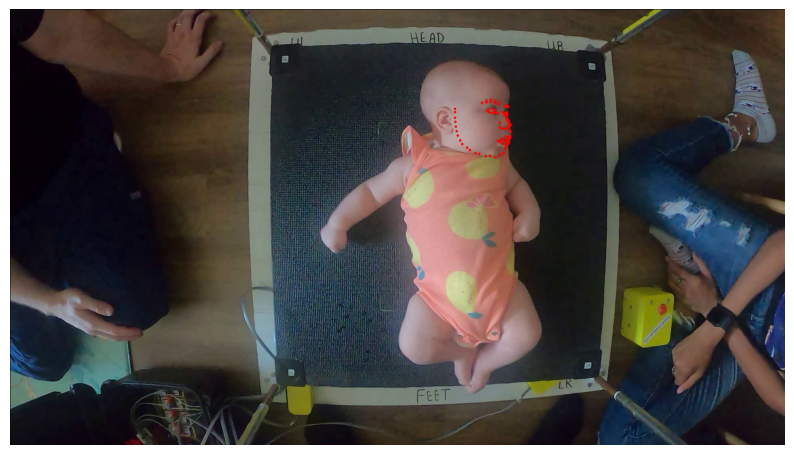

Displayed frame number: 2400


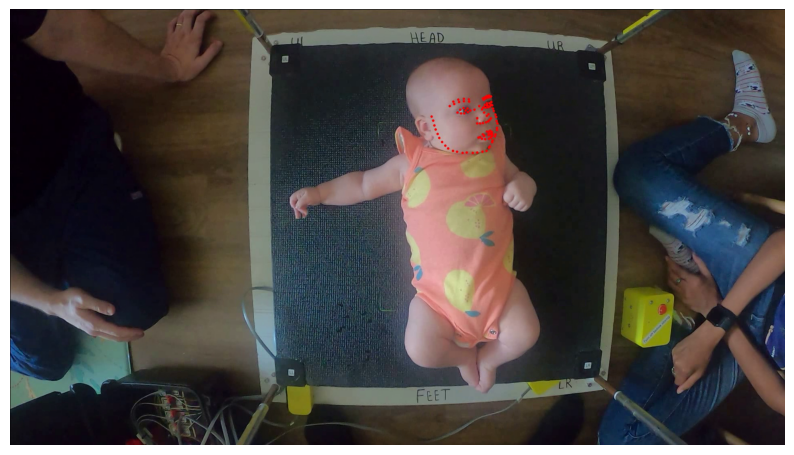

Displayed frame number: 2500


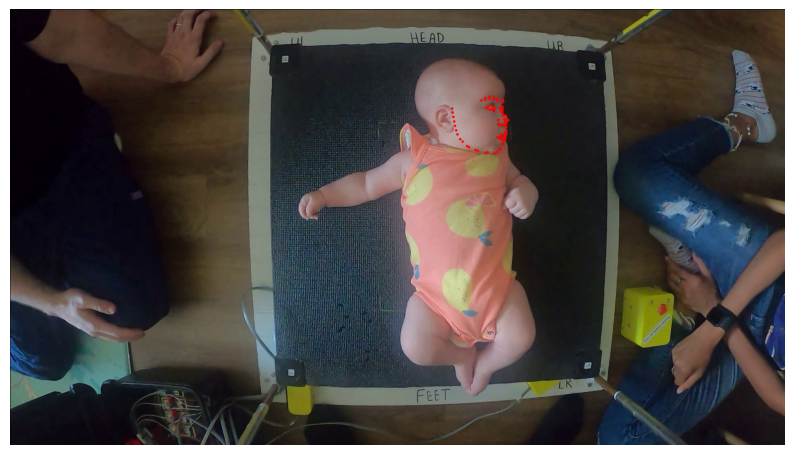

Displayed frame number: 2600


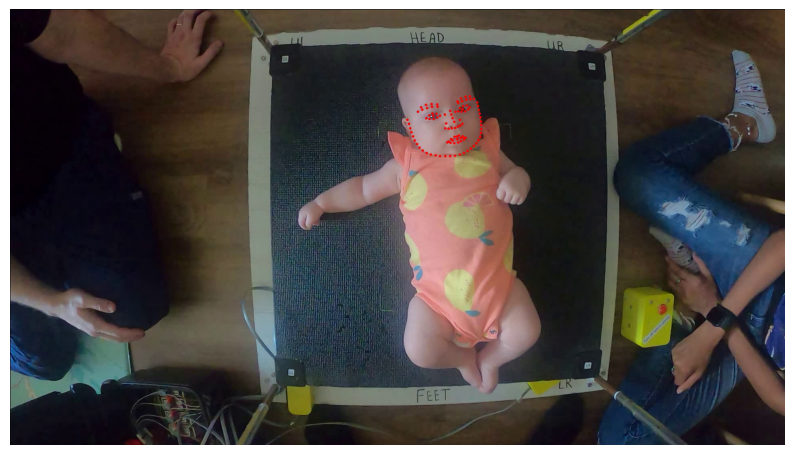

Displayed frame number: 2700


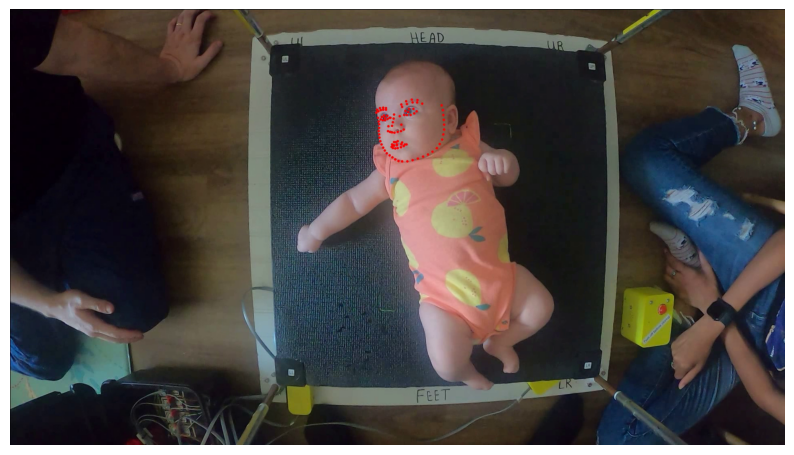

Displayed frame number: 2800


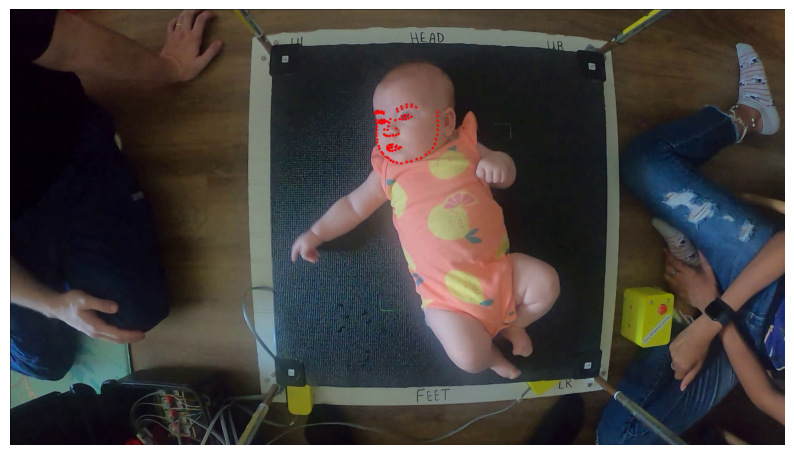

Displayed frame number: 2900


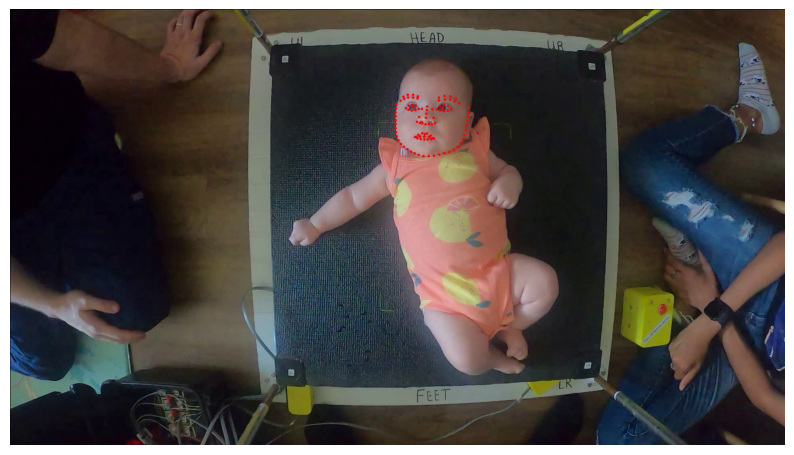

Displayed frame number: 3000


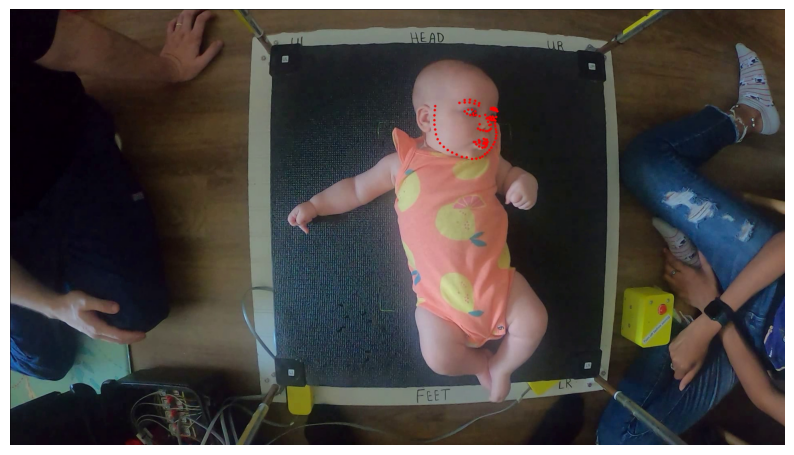

Displayed frame number: 3100


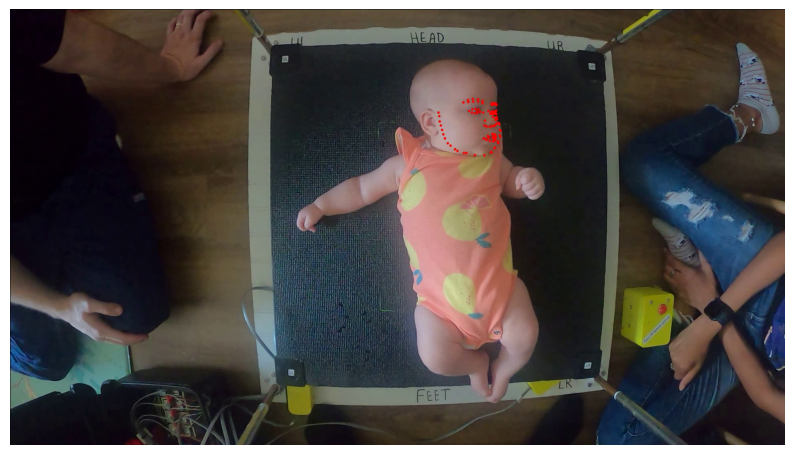

Displayed frame number: 3200


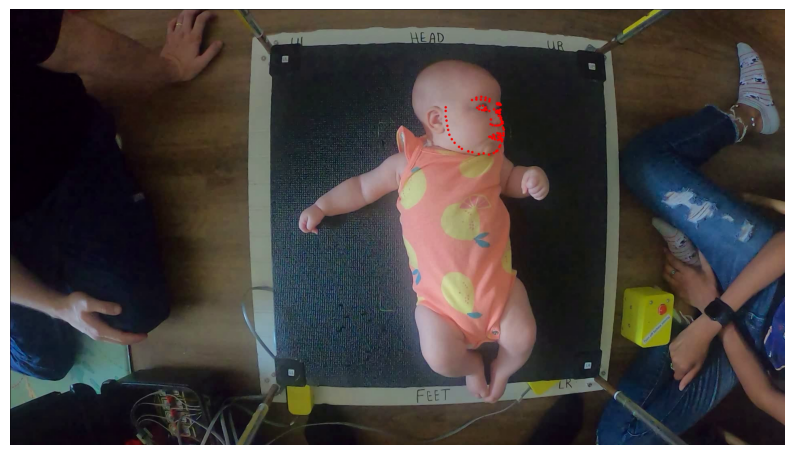

Displayed frame number: 3300


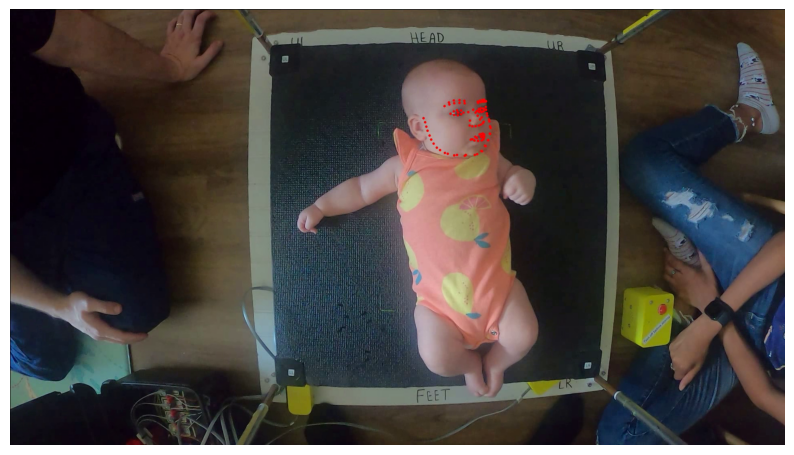

Displayed frame number: 3400


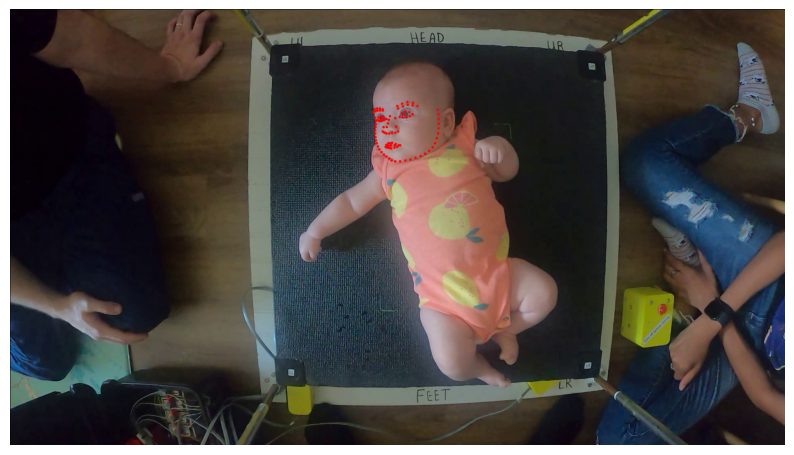

Displayed frame number: 3500


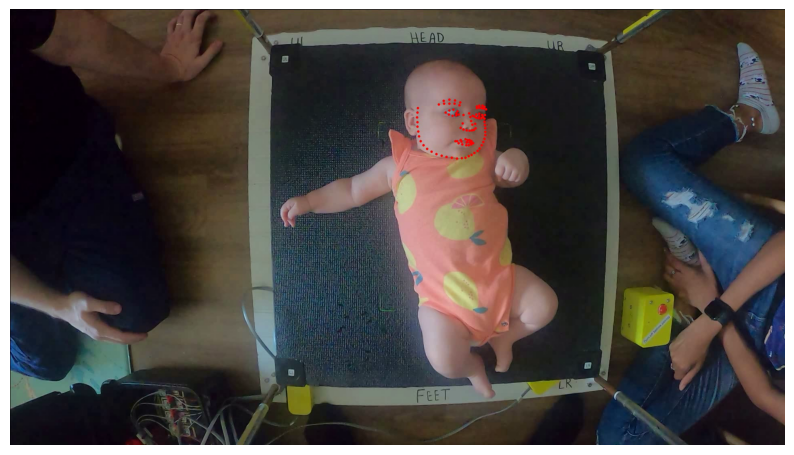

Displayed frame number: 3600


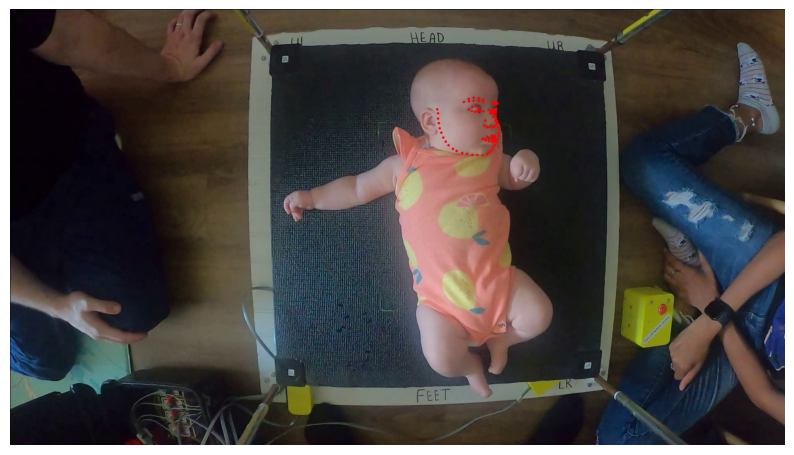

Displayed frame number: 3700


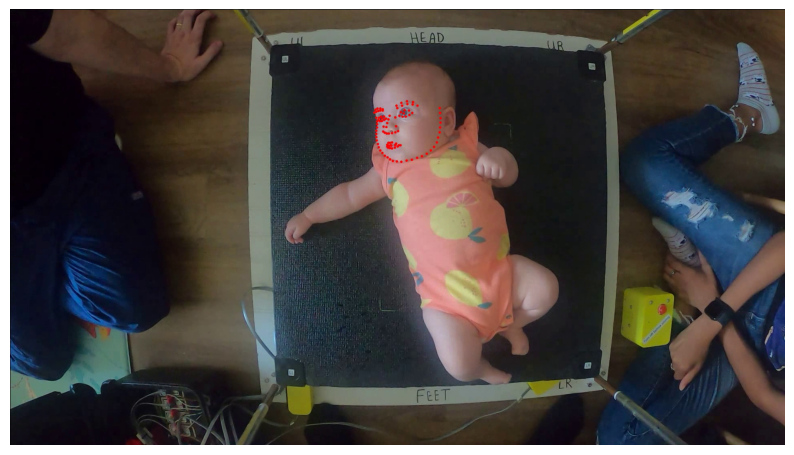

Displayed frame number: 3800


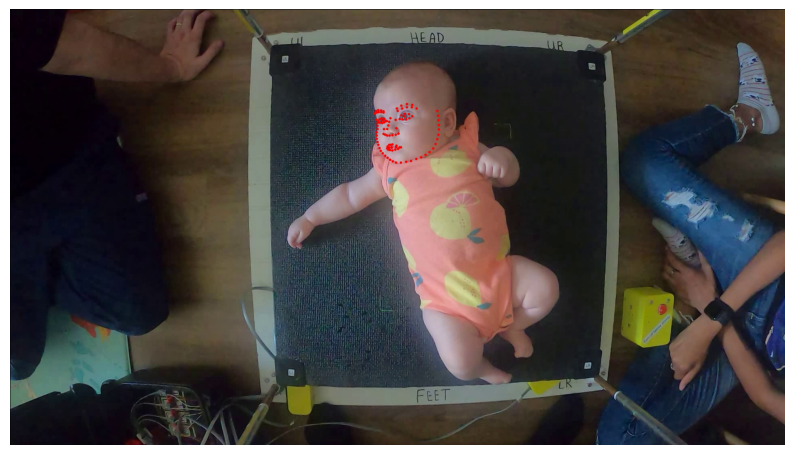

Displayed frame number: 3900


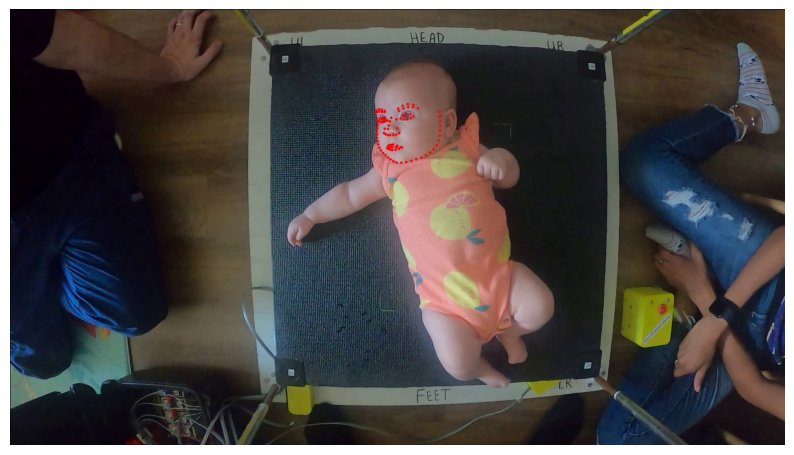

Displayed frame number: 4000


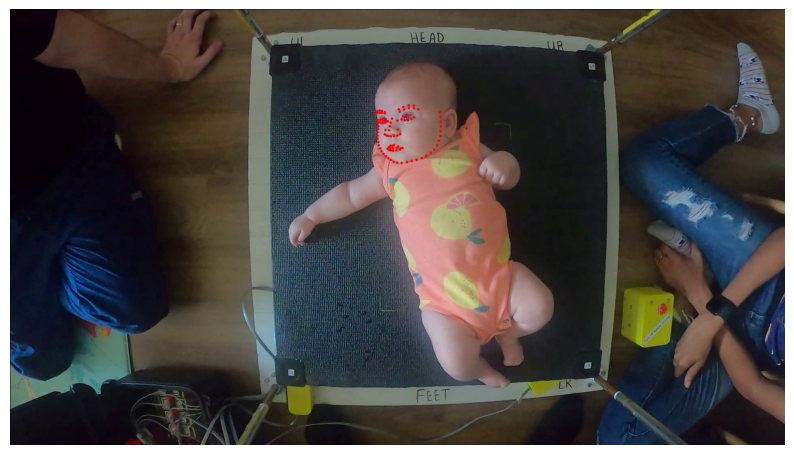

Displayed frame number: 4100


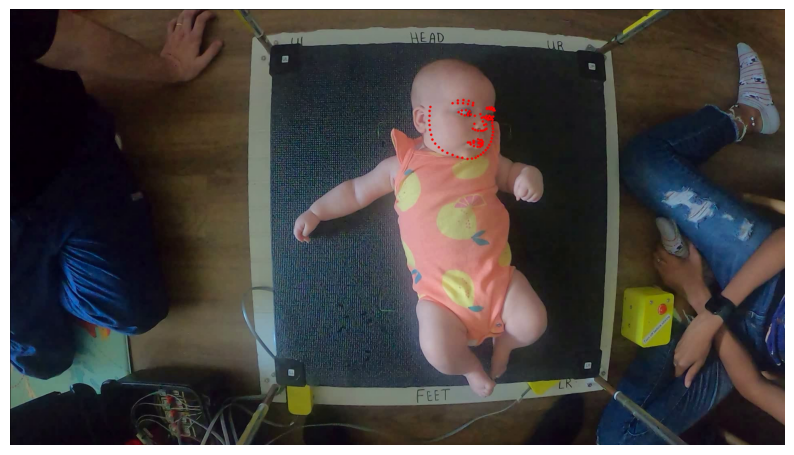

Displayed frame number: 4200


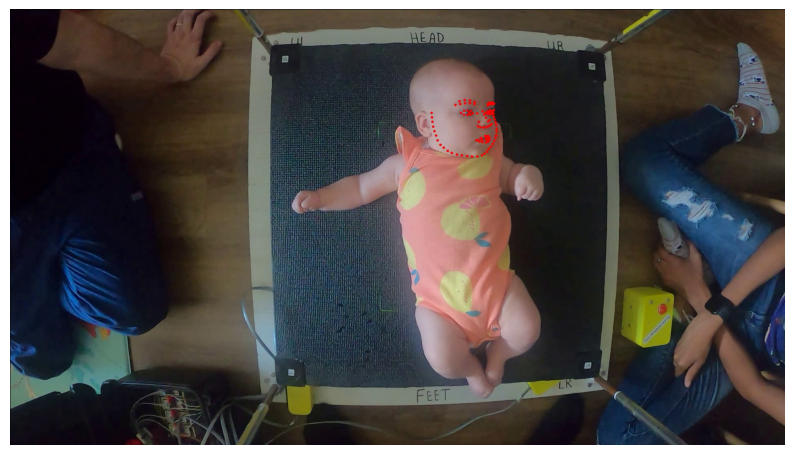

Displayed frame number: 4300


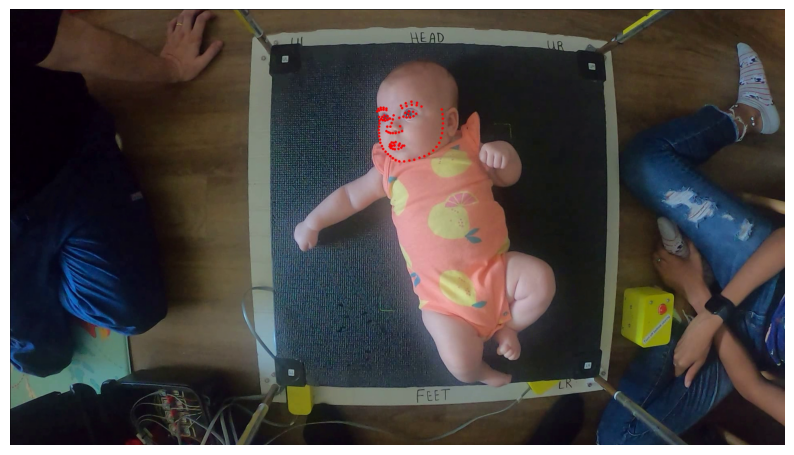

Displayed frame number: 4400


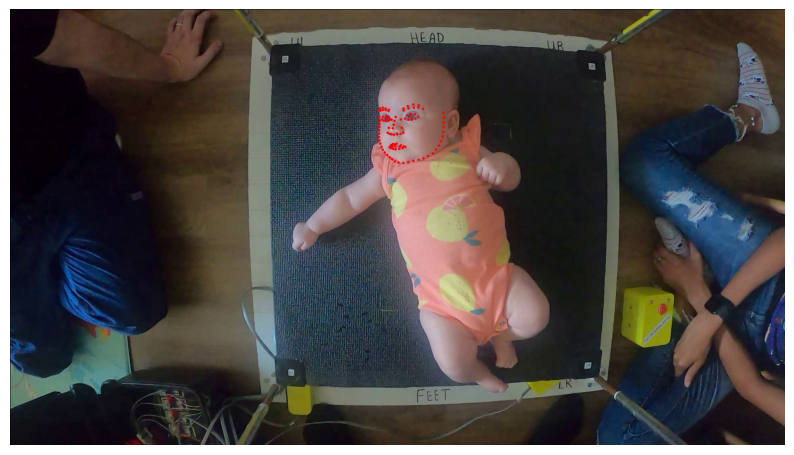

Displayed frame number: 4500


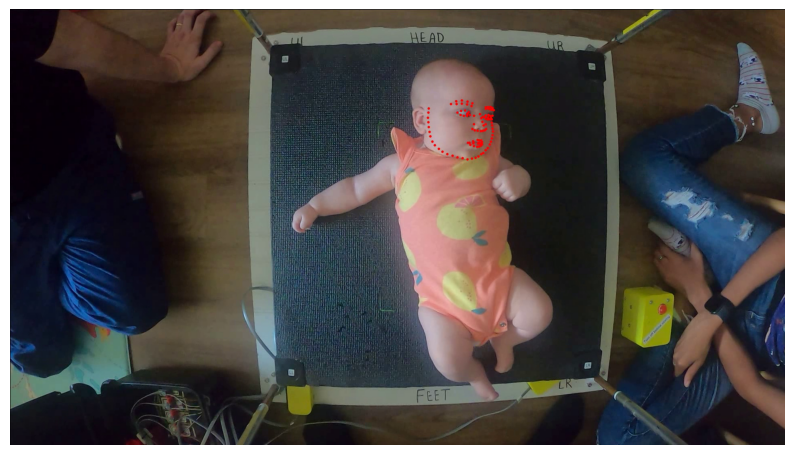

Displayed frame number: 4600


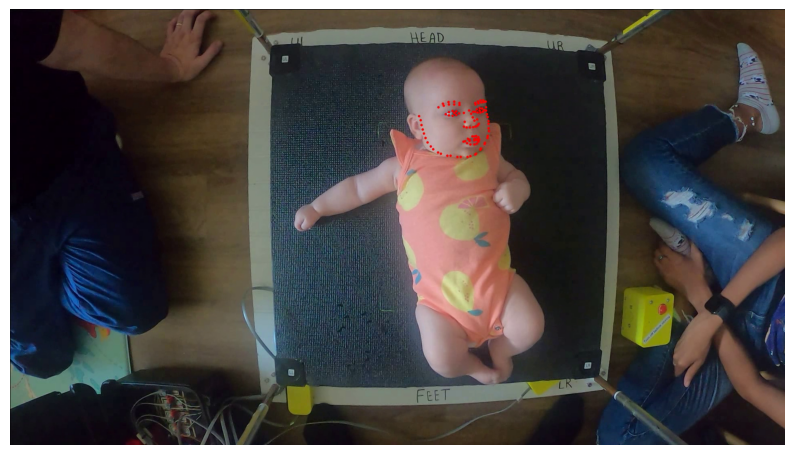

Displayed frame number: 4700


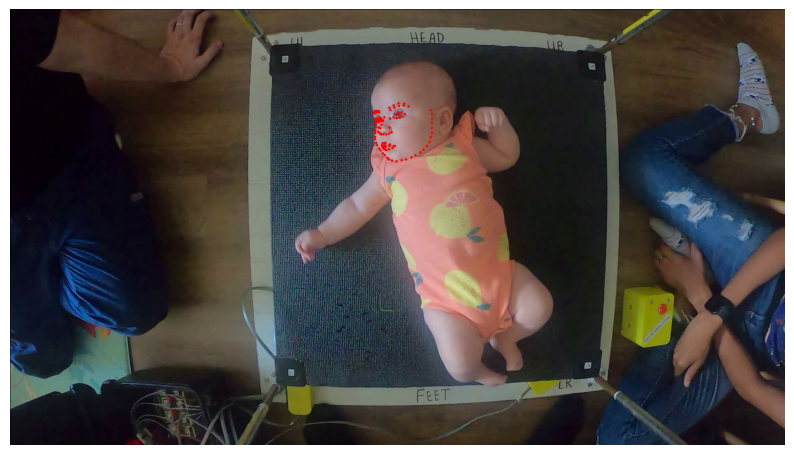

Displayed frame number: 4800


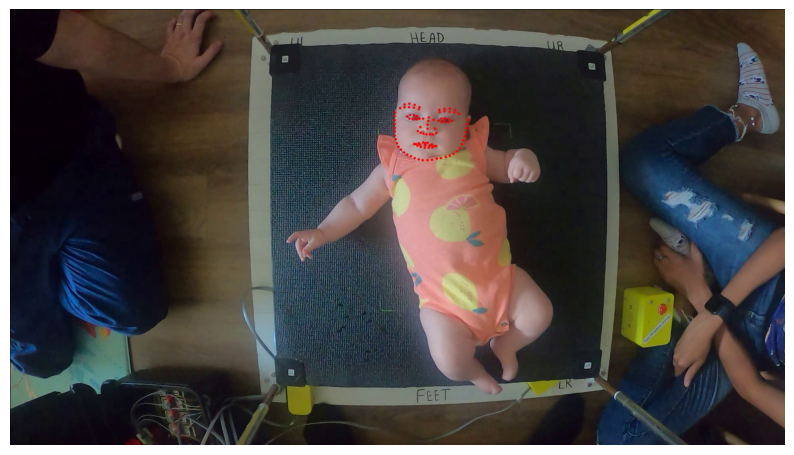

Displayed frame number: 4900


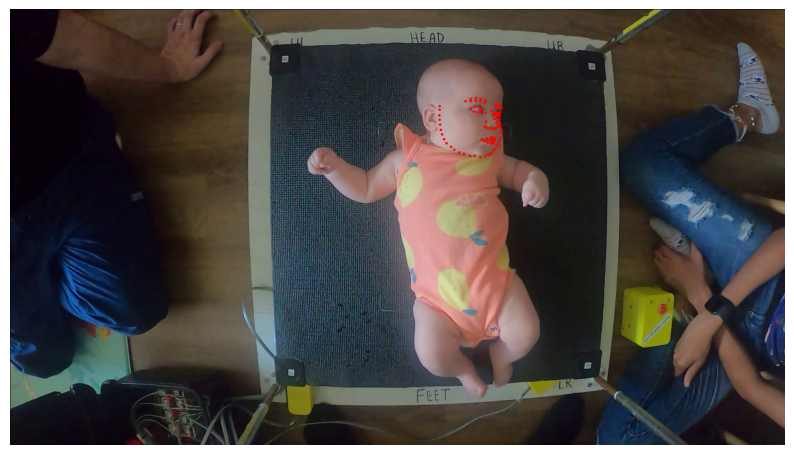

Displayed frame number: 5000


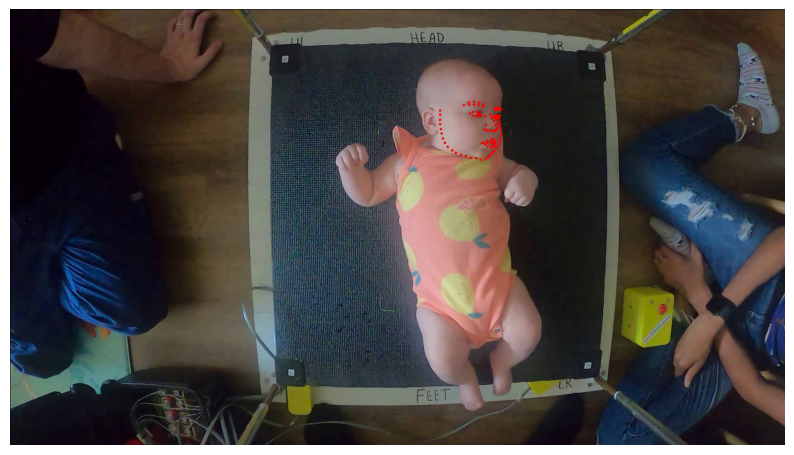

Displayed frame number: 5100


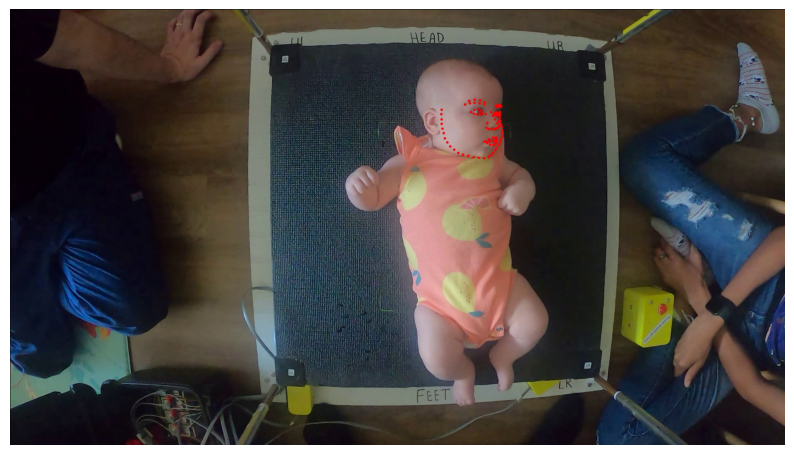

Displayed frame number: 5200


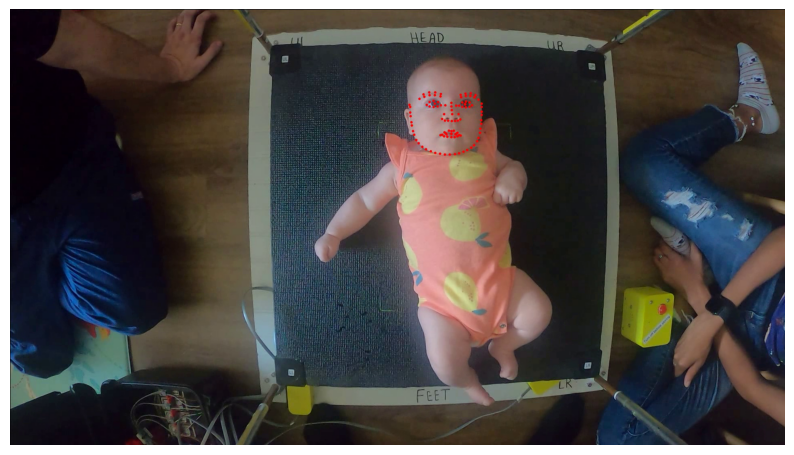

Displayed frame number: 5300


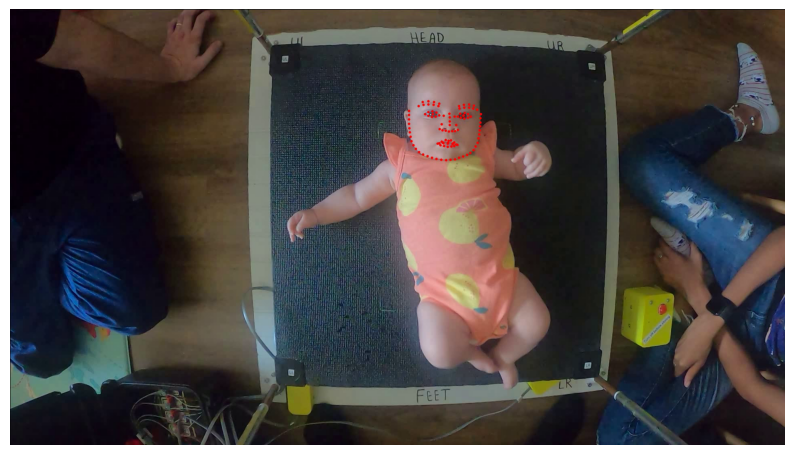

Displayed frame number: 5400


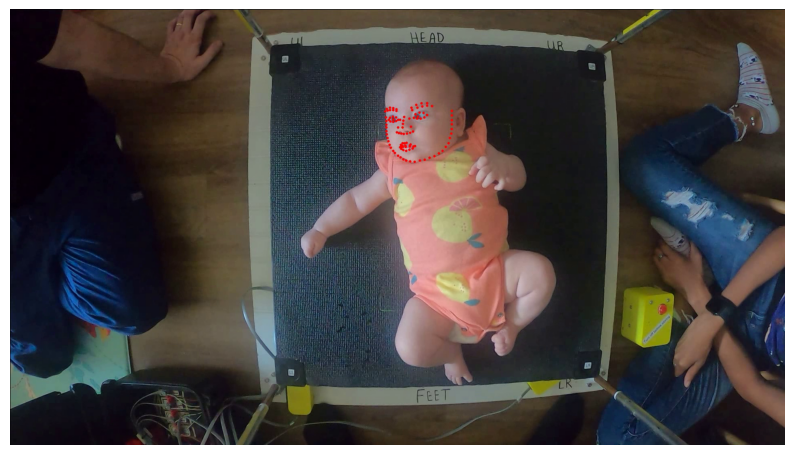

Displayed frame number: 5500


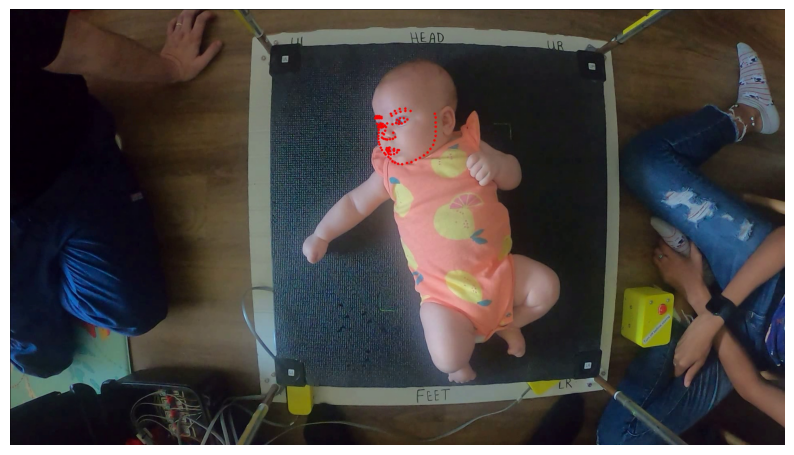

Displayed frame number: 5600


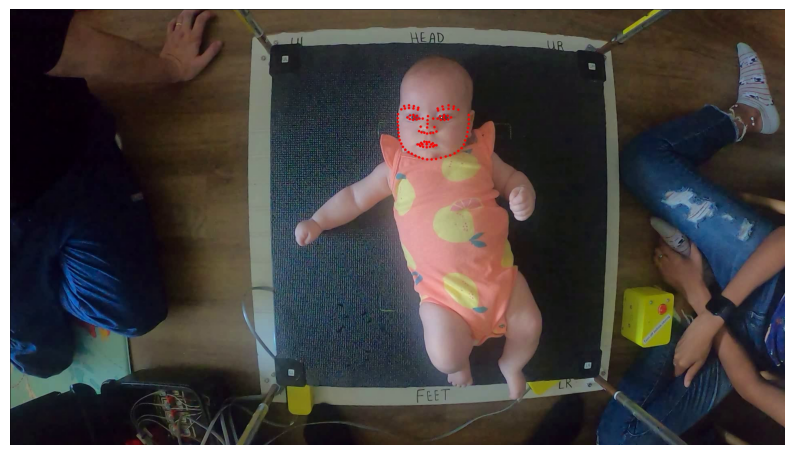

Displayed frame number: 5700


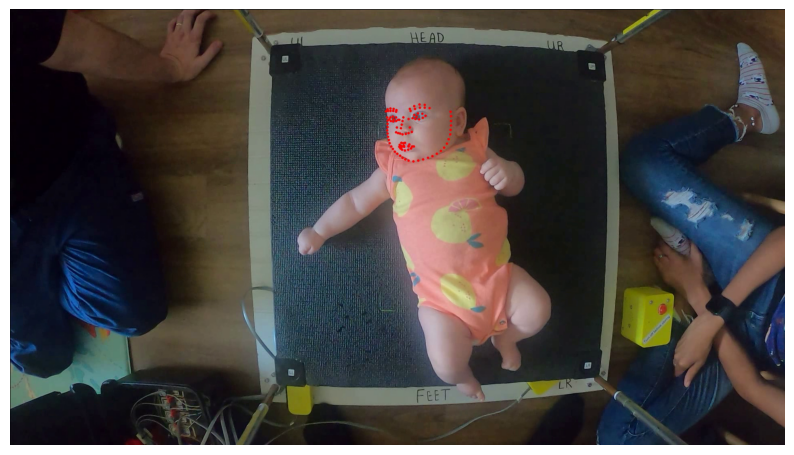

Displayed frame number: 5800


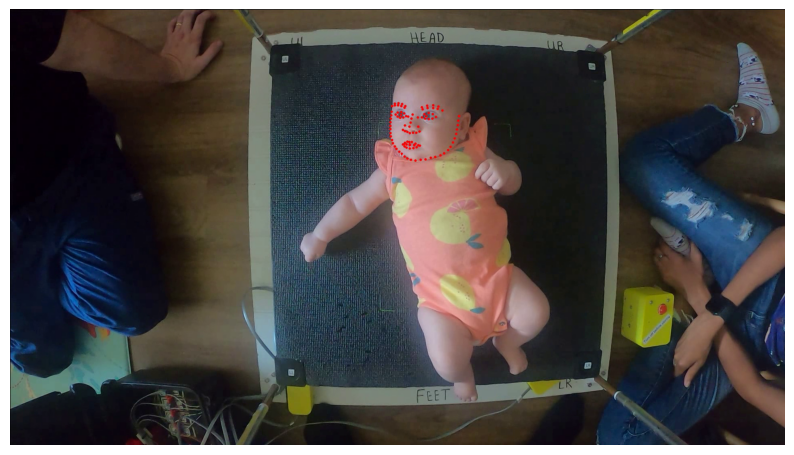

Displayed frame number: 5900


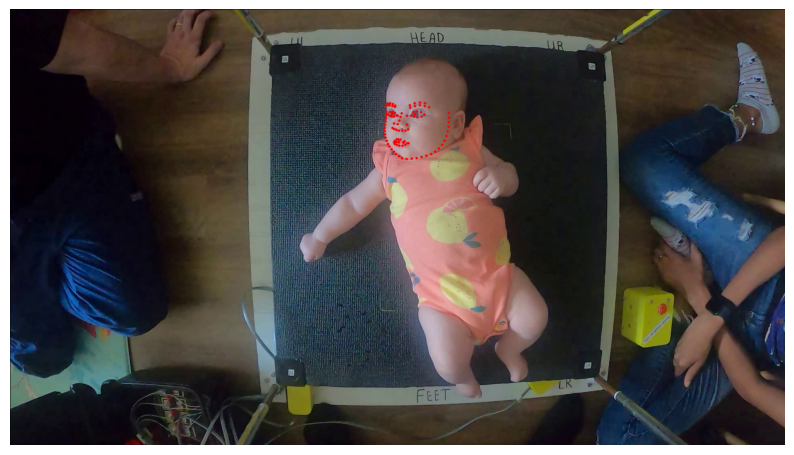

Displayed frame number: 6000


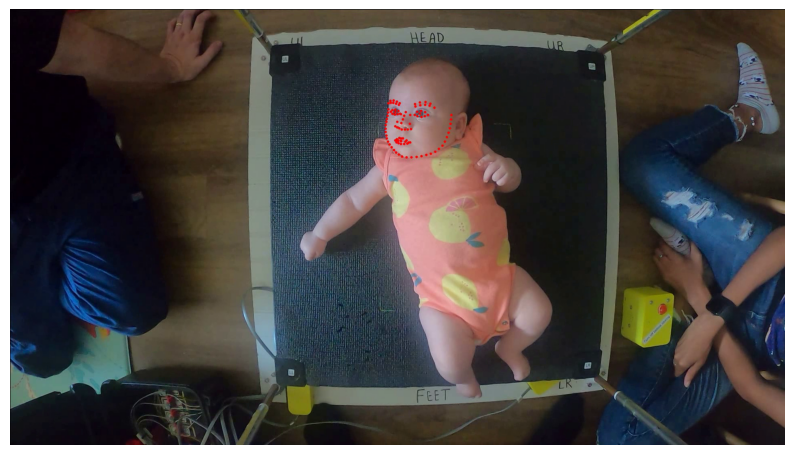

Displayed frame number: 6100


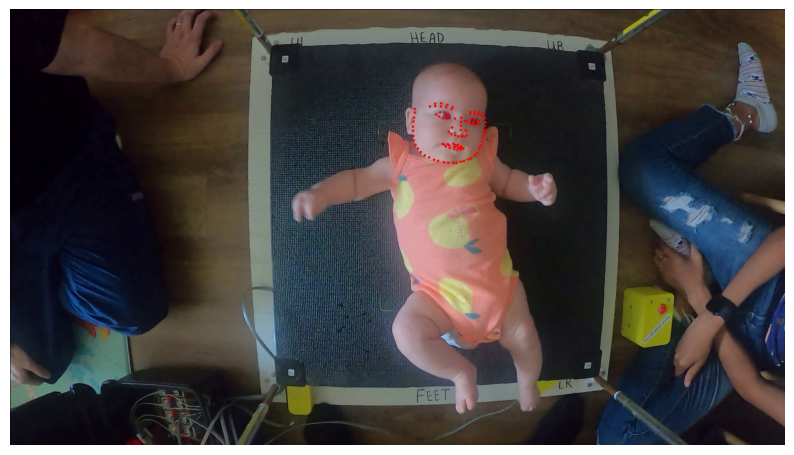

Displayed frame number: 6200


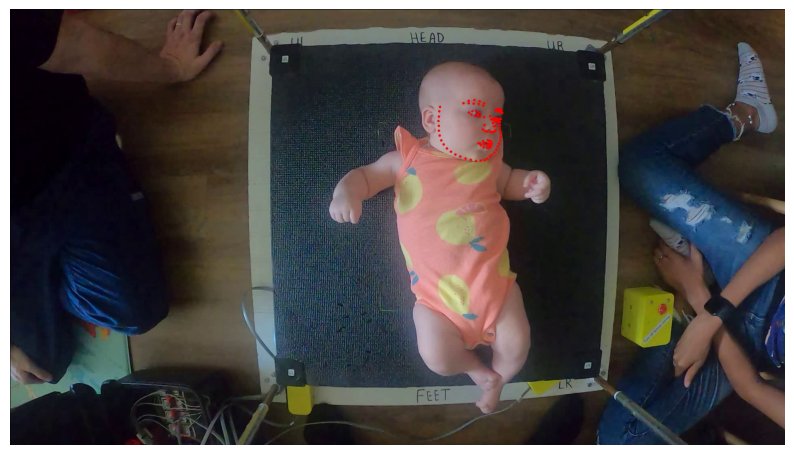

Displayed frame number: 6300


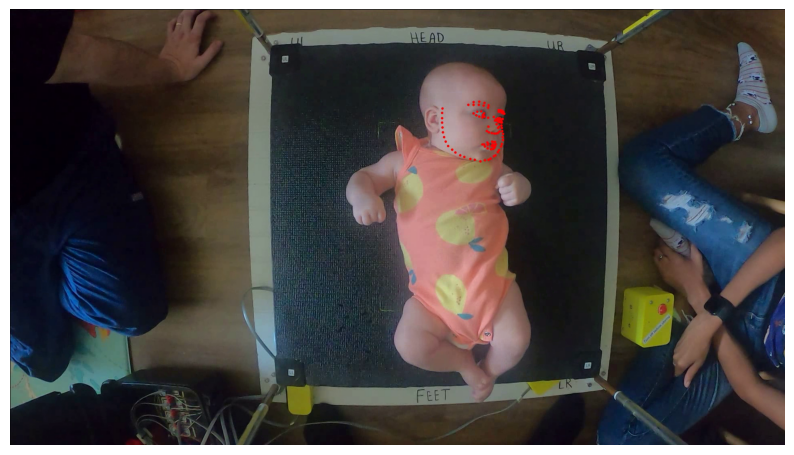

Displayed frame number: 6400


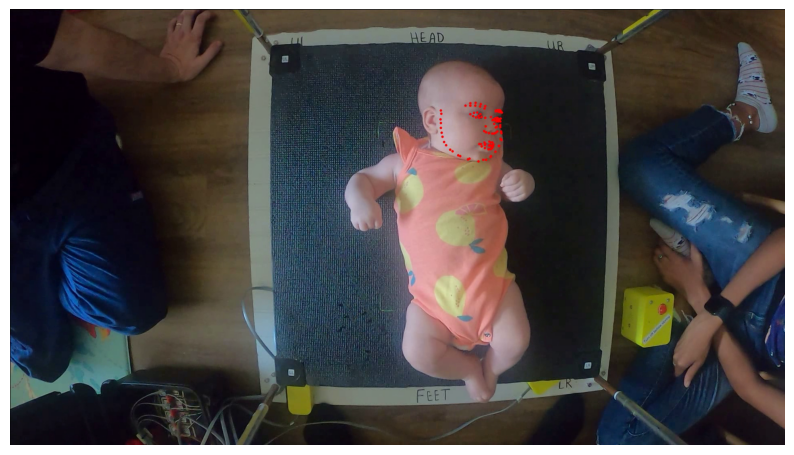

Displayed frame number: 6500


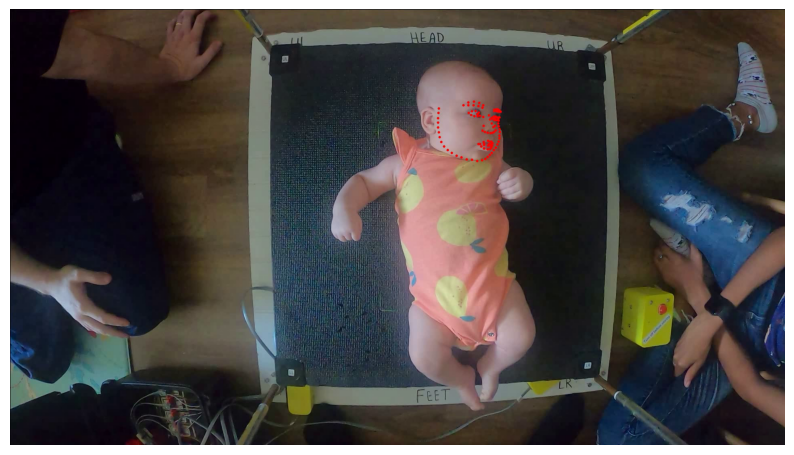

Displayed frame number: 6600


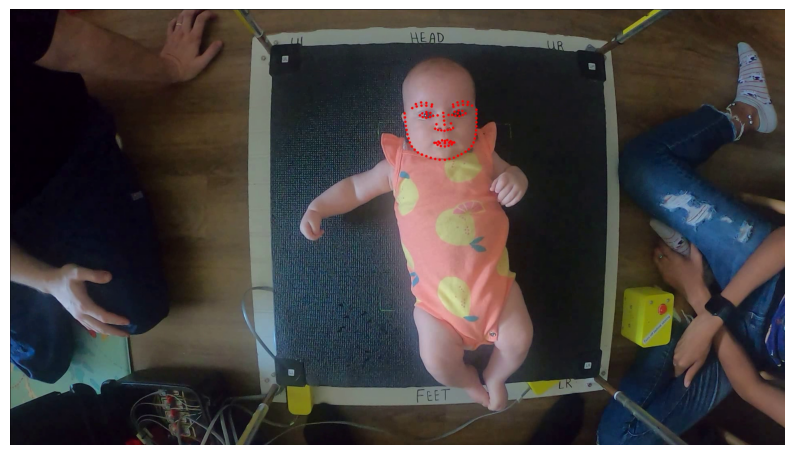

Displayed frame number: 6700


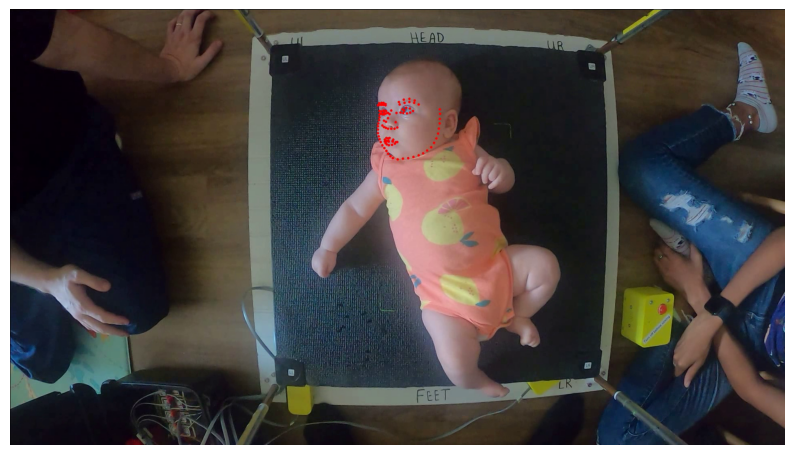

Displayed frame number: 6800


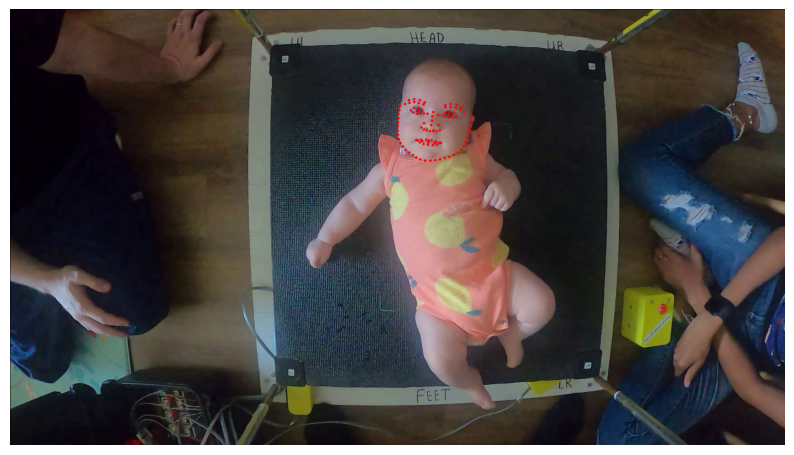

Displayed frame number: 6900


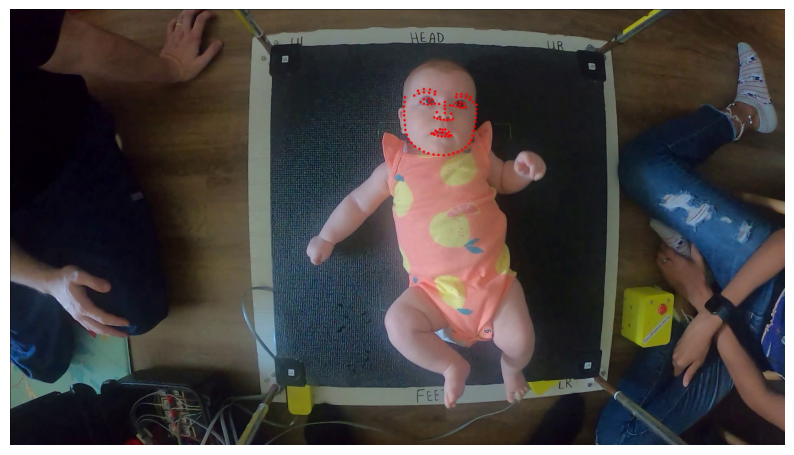

Displayed frame number: 7000


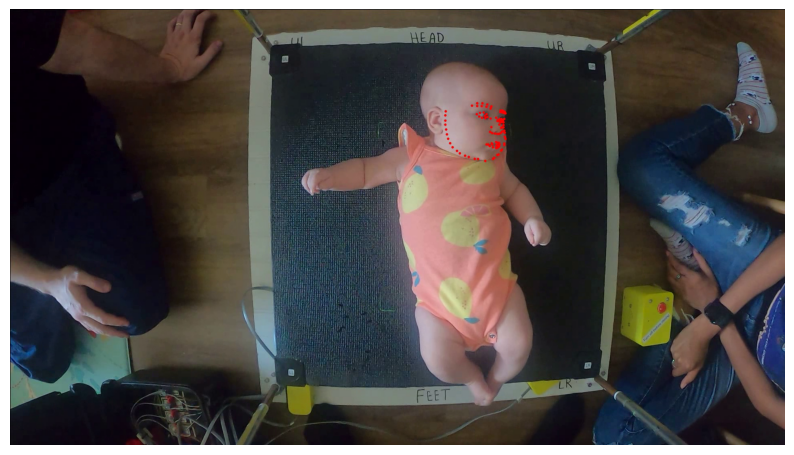

Displayed frame number: 7100


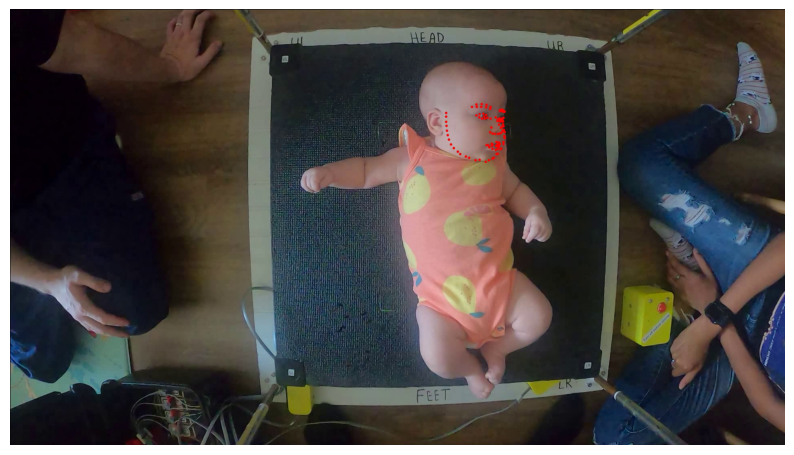

Displayed frame number: 7200


In [50]:
# import time

def display_frames(video_path):
    # Define the range of frames (0 to 7200)
    start_frame = 0
    end_frame = 7200
    increment = 100

    # Loop through the range in increments of 50
    for frame_number in range(start_frame, end_frame + 1, increment):
        # Call the display function for the current frame
        display_frame_panda_1_3(frame_number, video_path)
        
        # Print the frame number
        print(f"Displayed frame number: {frame_number}")
        
        # Wait for 5 seconds before displaying the next frame
        time.sleep(8)

video_path = '/workspaces/wiggle-face/data-ioana/PANDA3/face/vis/r_2022_07_01_833180_211_cam3_vid4.mp4'
display_frames(video_path)

# Loading 2

In [51]:
data_emotion = pd.read_csv('/workspaces/wiggle-face/data-ioana/PANDA3/good_manual_labels_data.csv')

In [52]:
data_emotion

,Unnamed: 0,video,frame_id,emotion,brain_injury
0,0,r_2024_02_23_833180_242_cam3_vid4,1,neutral,1
1,1,r_2024_02_23_833180_242_cam3_vid4,2,neutral,1
2,2,r_2024_02_23_833180_242_cam3_vid4,3,neutral,1
3,3,r_2024_02_23_833180_242_cam3_vid4,4,neutral,1
4,4,r_2024_02_23_833180_242_cam3_vid4,5,neutral,1
...,...,...,...,...,...
165595,165595,r_2022_07_01_833180_211_cam3_vid4,7196,neutral,1
165596,165596,r_2022_07_01_833180_211_cam3_vid4,7197,neutral,1
165597,165597,r_2022_07_01_833180_211_cam3_vid4,7198,neutral,1
165598,165598,r_2022_07_01_833180_211_cam3_vid4,7199,neutral,1


In [53]:
emotion_counts = data_emotion['emotion'].value_counts()
print(emotion_counts)

neutral     68393
interest    36406
sleepy      19786
anger       17279
sadness     16223
playful      3891
surprise     2939
sandess       212
inetrest      165
surpise       106
Name: emotion, dtype: int64


In [57]:
label_renaming = {
    'inetrest': 'interest',
    'surpise': 'surprise',
    'sandess' : 'sadness ',
}

# Rename the labels in the 'emotion' column
data_emotion['emotion'] = data_emotion['emotion'].replace(label_renaming)

emotion_counts = data_emotion['emotion'].value_counts()
print(emotion_counts)

neutral     68393
interest    36571
sleepy      19786
anger       17279
sadness     16435
playful      3891
surprise     3045
Name: emotion, dtype: int64


In [61]:
data_emotion = data_emotion.drop(columns = ['Unnamed: 0'])
data_emotion

,video,frame_id,emotion,brain_injury
0,r_2024_02_23_833180_242_cam3_vid4,1,neutral,1
1,r_2024_02_23_833180_242_cam3_vid4,2,neutral,1
2,r_2024_02_23_833180_242_cam3_vid4,3,neutral,1
3,r_2024_02_23_833180_242_cam3_vid4,4,neutral,1
4,r_2024_02_23_833180_242_cam3_vid4,5,neutral,1
...,...,...,...,...
165595,r_2022_07_01_833180_211_cam3_vid4,7196,neutral,1
165596,r_2022_07_01_833180_211_cam3_vid4,7197,neutral,1
165597,r_2022_07_01_833180_211_cam3_vid4,7198,neutral,1
165598,r_2022_07_01_833180_211_cam3_vid4,7199,neutral,1


In [62]:
def categorize_emotion(emotion):
    if emotion in ['interest', 'surprise', 'playful']:
        return 'positive'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['sadness', 'anger']:
        return 'negative'

def categorize_emotion_2(emotion):
    if emotion in ['anger', 'playful']:
        return 'intense'
    elif emotion in ['neutral', 'sleepy']:
        return 'neutral'
    elif emotion in ['interest', 'surprise', 'sadness']:
        return 'mild'
    
# Apply the categorization function to create 'emotion_category'
data_emotion['emotion_category'] = data_emotion['emotion'].apply(categorize_emotion)
data_emotion['emotion_category_2'] = data_emotion['emotion'].apply(categorize_emotion_2)

In [63]:
data_emotion

,video,frame_id,emotion,brain_injury,emotion_category,emotion_category_2
0,r_2024_02_23_833180_242_cam3_vid4,1,neutral,1,neutral,neutral
1,r_2024_02_23_833180_242_cam3_vid4,2,neutral,1,neutral,neutral
2,r_2024_02_23_833180_242_cam3_vid4,3,neutral,1,neutral,neutral
3,r_2024_02_23_833180_242_cam3_vid4,4,neutral,1,neutral,neutral
4,r_2024_02_23_833180_242_cam3_vid4,5,neutral,1,neutral,neutral
...,...,...,...,...,...,...
165595,r_2022_07_01_833180_211_cam3_vid4,7196,neutral,1,neutral,neutral
165596,r_2022_07_01_833180_211_cam3_vid4,7197,neutral,1,neutral,neutral
165597,r_2022_07_01_833180_211_cam3_vid4,7198,neutral,1,neutral,neutral
165598,r_2022_07_01_833180_211_cam3_vid4,7199,neutral,1,neutral,neutral


In [65]:
data_emotion.to_csv('final_data_for_Francis.csv')